<a href="https://colab.research.google.com/github/phillipesplanet/Projeto-Aurifero/blob/master/Modelo_ThK_resultados_relatorio_parcial_2021.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


#MODELO PARA DETECÇÃO DE ANOMALIAS DE BAIXOS VALORES DA RAZÃO TH/K USANDO YOLOv5
##Etapas deste notebook:
*   Preprocessamento
*   Rede YOLOv5
*   Treino da rede YOLOv5
*   Resultados



#Preprocessamento
##Importando bibliotecas:

In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone repository github
%cd yolov5
!git reset --hard 68211f72c99915a15855f7b99bf5d93f5631330f
import torch
from IPython.display import Image  # imagem display
from utils.google_utils import gdrive_download  # downloading models/datasets

print('torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

fatal: destination path 'yolov5' already exists and is not an empty directory.
/content/yolov5
HEAD is now at 68211f7 FROM nvcr.io/nvidia/pytorch:20.10-py3 (#1553)
torch 1.7.0+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


##Carregando datasets de treino, validação e teste:

In [ ]:
%cd /content
!curl -L "https://app.roboflow.com/ds/8buXSqt5QT?key=p07nCSsh5W" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0   1668      0 --:--:-- --:--:-- --:--:--  1668
100 12.0M  100 12.0M    0     0  16.2M      0 --:--:-- --:--:-- --:--:--  449M
Archive:  roboflow.zip
replace README.roboflow.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace data.yaml? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace test/images/0003_jpg.rf.3328b96fe2f3de3973ce72d381b48874.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
 extracting: test/images/0003_jpg.rf.3328b96fe2f3de3973ce72d381b48874.jpg  
 extracting: test/images/0008_jpg.rf.80e0136e4ab3edd571481f3f2b1d4661.jpg  
 extracting: test/images/0011_jpg.rf.d88d646f8c986b39e610d00cc9a1609b.jpg  
 extracting: test/images/0017_jpg.rf.fdc256249f302a9a3c36aeb4f3e71c45.jpg  
 extracting: test/images/0018_jpg.rf.5ded7286b05cea49b64a11d1f5383c7e.jpg  
 extracting: test/images/0023_jpg.

##Número de classes: 1
##Nome da classe: 'ThK-anomaly'


In [ ]:
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['ThK-anomaly']

In [ ]:
import yaml

In [ ]:
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
num_classes

'1'

#Carregando a rede YOLOv5s
##Parametros da rede YOLOv5(small) utilizada para a criação do modelo:

In [ ]:
%cat /content/yolov5/models/yolov5s.yaml #configuração pre existente. para mudar consultar roboflow colab

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-

# TREINANDO A REDE YOLOv5s
Legenda dos Parametros da função train:

img: define input image size

batch: determine batch size

epochs: define the number of training epochs. (Note: often, 3000+ are common here!)
data: set the path to our yaml file

cfg: specify our model configuration

weights: specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive folder)

name: result names

nosave: only save the final checkpoint

cache: cache images for faster training

In [ ]:
yaml.__version__

'5.4.1'

In [ ]:
import glob
from IPython.display import Image, display

In [ ]:
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 16 --epochs 750 --data '../data.yaml' --cfg ./models/yolov5s.yaml --weights '' --name yolov5s_results_wave4  --cache

/content/yolov5
Using torch 1.7.0+cu101 CUDA:0 (Tesla T4, 15109MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/yolov5s.yaml', data='../data.yaml', device='', epochs=750, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], local_rank=-1, log_imgs=16, multi_scale=False, name='yolov5s_results_wave4', noautoanchor=False, nosave=False, notest=False, project='runs/train', rect=False, resume=False, save_dir='runs/train/yolov5s_results_wave42', single_cls=False, sync_bn=False, total_batch_size=16, weights='', workers=8, world_size=1)
Start Tensorboard with "tensorboard --logdir runs/train", view at http://localhost:6006/
2021-02-17 00:30:43.850946: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
Hyperparameters {'lr0': 0.01, 'lrf': 0.2, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'warmup_momentum': 0.8,

##Curvas de aprendizagem para o treinamento

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

#RESULTADOS
##Usando os melhores pesos para detectar as anomalias nas imagem do dataset de teste:

In [ ]:
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results_wave42/weights/best.pt --img 416 --conf 0.4 --source ../test/images

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=False, source='../test/images', update=False, view_img=False, weights=['runs/train/yolov5s_results_wave42/weights/best.pt'])
Using torch 1.7.0+cu101 CUDA:0 (Tesla T4, 15109MB)

Fusing layers... 
Model Summary: 232 layers, 7246518 parameters, 0 gradients
image 1/9 /content/test/images/0003_jpg.rf.3328b96fe2f3de3973ce72d381b48874.jpg: 416x416 13 ThK-anomalys, Done. (0.010s)
image 2/9 /content/test/images/0008_jpg.rf.80e0136e4ab3edd571481f3f2b1d4661.jpg: 416x416 15 ThK-anomalys, Done. (0.009s)
image 3/9 /content/test/images/0011_jpg.rf.d88d646f8c986b39e610d00cc9a1609b.jpg: 416x416 8 ThK-anomalys, Done. (0.009s)
image 4/9 /content/test/images/0017_jpg.rf.fdc256249f302a9a3c36aeb4f3e71c45.jpg: 416x416 8 ThK-anomalys, Done. (0.009s)
image 5/9 /content/test/images/0018_jpg.rf.5ded7286b05c

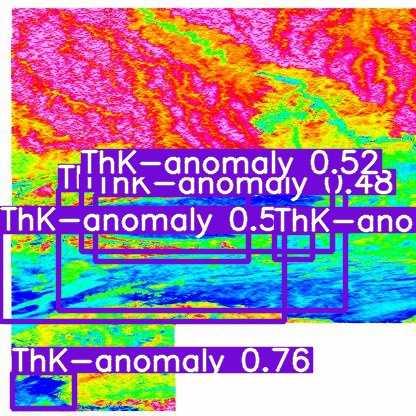

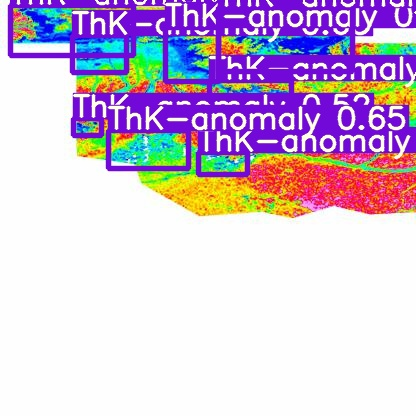

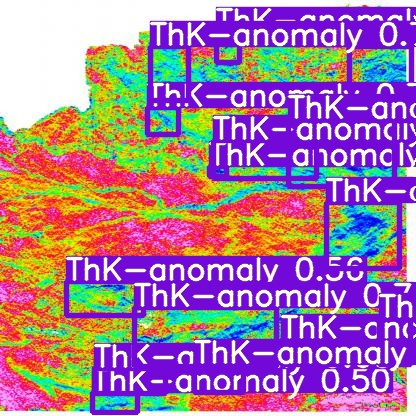

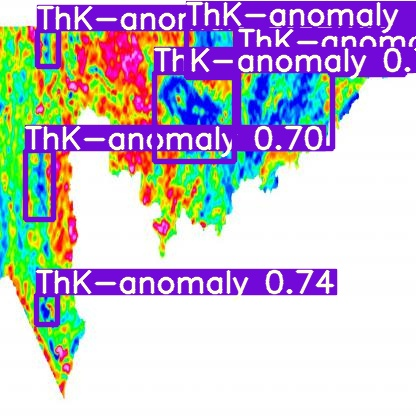

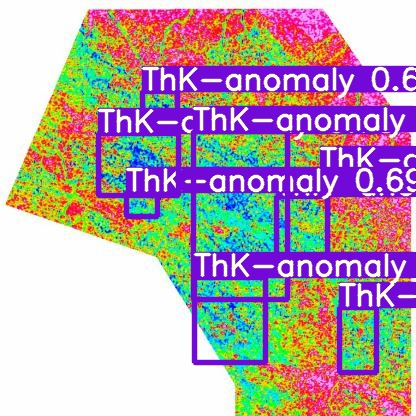

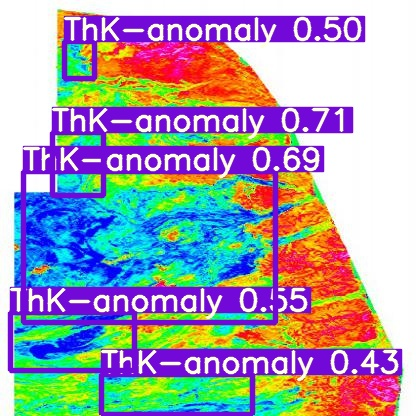

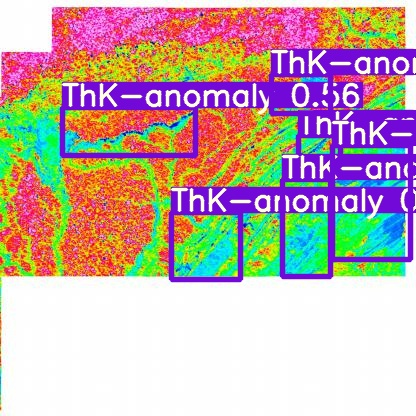

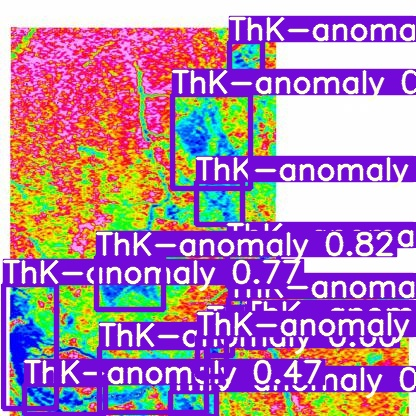

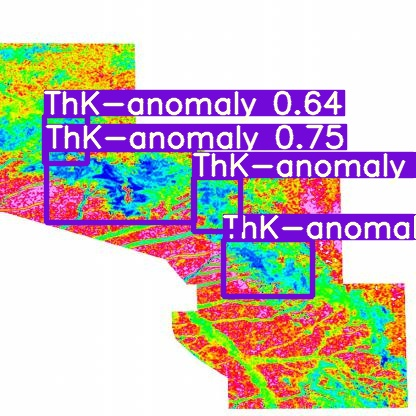

In [ ]:
for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

##Usando o modelo para detectar as anomalias no mapa da PAAF:

In [ ]:
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results_wave42/weights/best.pt --img 416 --conf 0.2 --source ../PAAF/paf_gama_ThK.jpg --save-txt

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.2, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=True, source='../PAAF/paf_gama_ThK.jpg', update=False, view_img=False, weights=['runs/train/yolov5s_results_wave42/weights/best.pt'])
Using torch 1.7.0+cu101 CUDA:0 (Tesla T4, 15109MB)

Fusing layers... 
Model Summary: 232 layers, 7246518 parameters, 0 gradients
image 1/1 /content/PAAF/paf_gama_ThK.jpg: 320x416 56 ThK-anomalys, Done. (0.015s)
Results saved to runs/detect/exp8
1 labels saved to runs/detect/exp8/labels
Done. (0.647s)


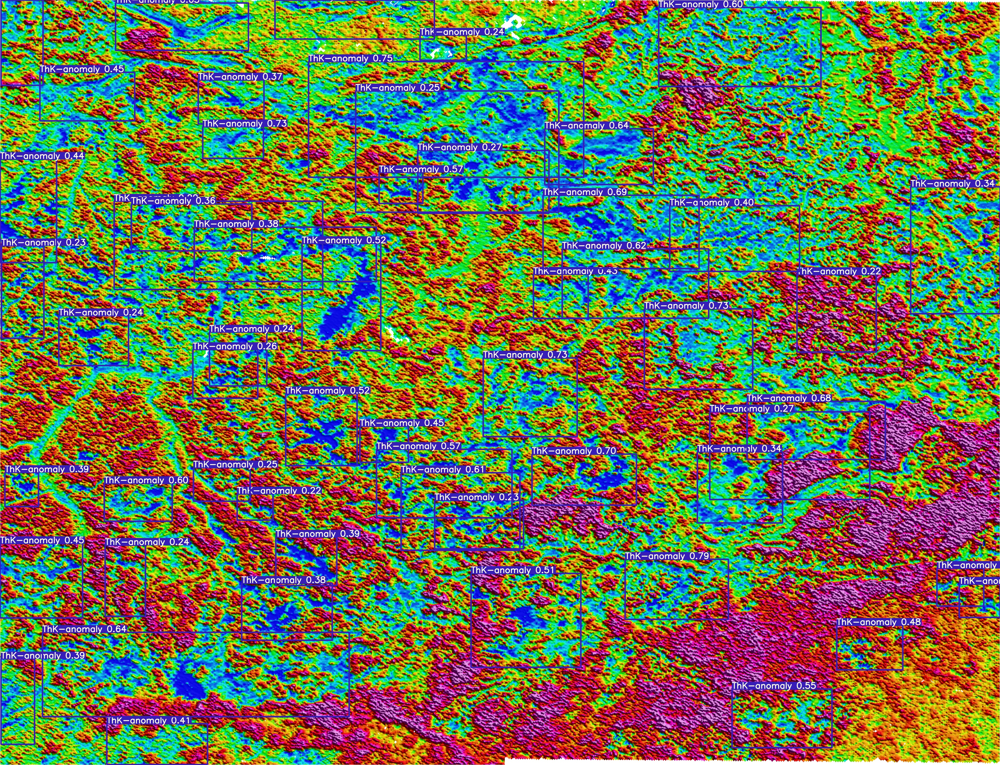

In [ ]:
for imageName in glob.glob('/content/yolov5/runs/detect/exp8/*.jpg'): 
    display(Image(filename=imageName))
    print("\n")

##Salvando os pesos no drive

In [ ]:
from google.colab import drive


In [ ]:
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
%cp /content/yolov5/runs/train/yolov5s_results_wave42/weights/best.pt /content/gdrive/My\ Drive